In [8]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import os
from glob import glob
import cv2
import numpy as np

In [2]:
data_root = "/disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup"

In [3]:
#path_ = os.path.join(data_root, "label") + "/*.png"
path_ = os.path.join(data_root) + "/*.png"

In [4]:
path_

'/disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup/*.png'

In [5]:
img_path = sorted(glob(path_))[0]

In [15]:
img_ = Image.open(sorted(glob(path_))[0])

filename /disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup/M2A1Slammer_.png


In [17]:

def sharpen_image(image, output_path):
    # 이미지 읽기
    #image = cv2.imread(image_path)
    image = np.asarray(image)

    if image is None:
        print("Error: Unable to read the image.")
        return

    # 샤프닝 커널 정의
    sharpening_kernel = np.array([[0, -1,  0],
                                   [-1,  5, -1],
                                   [0, -1,  0]])

    # 필터를 이용해 샤프닝 적용
    sharpened = cv2.filter2D(image, -1, sharpening_kernel)
    sharpened = Image.fromarray(sharpened)
    
    sharpened.save("output_image.png", format="PNG")

    
    return sharpened

    # 결과 저장
    #cv2.imwrite(output_path, sharpened)
    #print(f"Sharpened image saved to {output_path}")


#-------

a = sharpen_image(img_, "output_image.jpg")


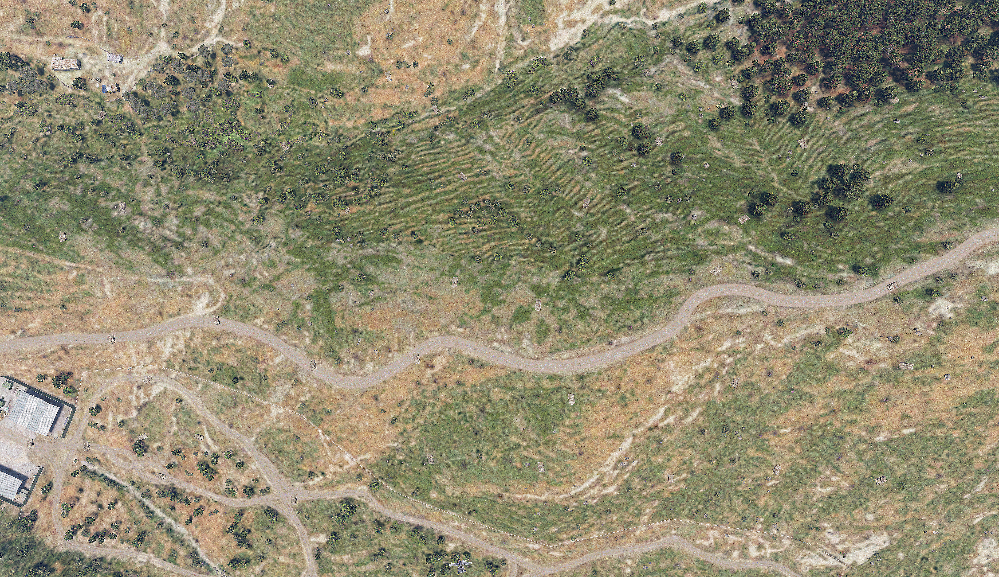

In [14]:
a

In [11]:

def split_save(path,target_folder):

    image = Image.open(path)
    #num_ = path.split("/")[-3].split("_")[-1]
    num_ = path.split("/")[-1].split(".")[0]
    width, height = image.size

    # 4분할된 이미지의 크기를 계산합니다
    half_width = width // 2
    half_height = height // 2

    # 각 4분할 영역을 자릅니다
    top_left = image.crop((0, 0, half_width, half_height))
    top_right = image.crop((half_width, 0, width, half_height))
    bottom_left = image.crop((0, half_height, half_width, height))
    bottom_right = image.crop((half_width, half_height, width, height))

    # 잘라낸 이미지를 각각 저장합니다
    top_left.save(os.path.join( target_folder, f"{num_}_top_left.png"))
    top_right.save(os.path.join( target_folder, f"{num_}_top_right.png"))
    bottom_left.save(os.path.join( target_folder, f"{num_}_bottom_left.png"))
    bottom_right.save(os.path.join( target_folder, f"{num_}_bottom_right.png"))

    print("Images have been saved.")

In [32]:
def split_save_16(path, target_folder):
    image = Image.open(path)
    num_ = path.split("/")[-1].split(".")[0]  # 파일명 추출
    width, height = image.size

    # 16분할된 이미지의 크기를 계산합니다
    quarter_width = width // 4
    quarter_height = height // 4

    # 각 16분할 영역을 자릅니다
    crops = []
    for row in range(4):
        for col in range(4):
            left = col * quarter_width
            upper = row * quarter_height
            right = left + quarter_width
            lower = upper + quarter_height
            crops.append((left, upper, right, lower))

    # 각 잘라낸 이미지 저장
    for i, crop in enumerate(crops):
        cropped_image = image.crop(crop)
        cropped_image.save(os.path.join(target_folder, f"{num_}_part_{i + 1}.png"))

    print("16-part images have been saved.")

In [33]:
from PIL import Image
import os

def split_save_25(path, target_folder):
    image = Image.open(path)
    num_ = path.split("/")[-1].split(".")[0]  # 파일명 추출
    width, height = image.size

    # 25분할된 이미지의 크기를 계산합니다
    part_width = width // 5
    part_height = height // 5

    # 각 25분할 영역을 자릅니다
    crops = []
    for row in range(5):
        for col in range(5):
            left = col * part_width
            upper = row * part_height
            right = left + part_width
            lower = upper + part_height
            crops.append((left, upper, right, lower))

    # 각 잘라낸 이미지 저장
    for i, crop in enumerate(crops):
        cropped_image = image.crop(crop)
        cropped_image.save(os.path.join(target_folder, f"{num_}_part_{i + 1}.png"))

    print("25-part images have been saved.")


In [38]:
data_root

'/disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup'

In [46]:
#data_root = "/home/eric/data/military_data/tanks_20/image"
path_ = os.path.join(data_root) + "/*.png"
img_list = glob(path_)

In [48]:
img_list = sorted(img_list)

In [50]:
img_list

['/disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup/M2A1Slammer_.png']

In [51]:
data_root

'/disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup'

In [52]:
for img_path in img_list:
    print(img_path)
    split_save_25(img_path,"/disk3/eric/dataset/VISION_SOFS/WEAPON_4/splits")

/disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup/M2A1Slammer_.png
filename /disk3/eric/dataset/VISION_SOFS/WEAPON_4/backup/M2A1Slammer_.png
25-part images have been saved.


In [26]:
for img_path in img_list:
    print(img_path)
    split_save_16(img_path,"/disk3/eric/dataset/VISION_SOFS/WEAPON_1/train_split_16")

/disk3/eric/dataset/weapon_v1/train/001.png
filename /disk3/eric/dataset/weapon_v1/train/001.png
16-part images have been saved.
/disk3/eric/dataset/weapon_v1/train/002.png
filename /disk3/eric/dataset/weapon_v1/train/002.png
16-part images have been saved.
/disk3/eric/dataset/weapon_v1/train/003.png
filename /disk3/eric/dataset/weapon_v1/train/003.png
16-part images have been saved.
/disk3/eric/dataset/weapon_v1/train/004.png
filename /disk3/eric/dataset/weapon_v1/train/004.png
16-part images have been saved.
/disk3/eric/dataset/weapon_v1/train/005.png
filename /disk3/eric/dataset/weapon_v1/train/005.png
16-part images have been saved.
/disk3/eric/dataset/weapon_v1/train/007.png
filename /disk3/eric/dataset/weapon_v1/train/007.png
16-part images have been saved.
